# Preprocesamiento - EDA

## 1. Preprocesamiento. Adaptación a torch-geometric-temporal

https://arxiv.org/abs/2110.06324

In [1]:
import torch
import torch.nn.functional as F
import pandas as pd
import seaborn as sns
import networkx as nx
sns.set_palette("coolwarm_r")
import matplotlib.pyplot as plt
import numpy as np

from torch_geometric.data import Data, Dataset
from torch_geometric.nn import GCNConv

In [2]:
import os, sys

path = os.getcwd()

sys.path.insert(1, "/".join(path.split("/")[0:-1]))

In [3]:
from torch_geometric_temporal.nn.recurrent import GCLSTM

from torch_geometric_temporal.dataset import EnglandCovidDatasetLoader
from torch_geometric_temporal.signal import temporal_signal_split
from utils.dynamic_graph_temporal_signal import DynamicGraphTemporalSignalLen
from utils import powergrid

In [6]:
#çfolder_path = "/home/TFM/code_dataset2/datos/Natural Oscillation"
folder_path = "/Users/maguado/Documents/UGR/Master/TFM/datos_2/Natural Oscillation"


In [7]:
loader = powergrid.PowerGridDatasetLoader(folder_path, problem="regression")
_,_,_ =loader.process()
limit = 300
dataset_full = loader.get_dataset( target= 20, intro=300, step=20, limit=limit, one_ts_per_situation=False)

Processing dataset...
Processing:  row_307
Node:  0  not included, including...
Node:  1  not included, including...
Node:  2  not included, including...
Node:  3  not included, including...
Node:  4  not included, including...
Node:  5  not included, including...
Node:  6  not included, including...
Node:  7  not included, including...
Node:  8  not included, including...
Node:  9  not included, including...
Node:  10  not included, including...
Node:  11  not included, including...
Node:  12  not included, including...
Node:  13  not included, including...
Node:  14  not included, including...
Node:  15  not included, including...
Node:  16  not included, including...
Node:  17  not included, including...
Node:  18  not included, including...
Node:  19  not included, including...
Node:  20  not included, including...
Node:  21  not included, including...
Node:  22  not included, including...
Processing:  row_135
Processing:  row_75
Processing:  row_338
Processing:  row_81
Processing:

#### Plots

In [19]:
loader.transformation_dict

{101: 0,
 102: 1,
 151: 2,
 152: 3,
 153: 4,
 154: 5,
 201: 6,
 202: 7,
 203: 8,
 204: 9,
 205: 10,
 206: 11,
 211: 12,
 3001: 13,
 3002: 14,
 3003: 15,
 3004: 16,
 3005: 17,
 3006: 18,
 3007: 19,
 3008: 20,
 3011: 21,
 3018: 22}

In [16]:
loader.types

['bus_fault',
 'bus_trip',
 'gen_trip',
 'branch_fault',
 'gen_trip',
 'bus_trip',
 'gen_trip',
 'gen_trip',
 'branch_trip',
 'branch_trip',
 'gen_trip',
 'gen_trip',
 'bus_fault',
 'bus_fault',
 'branch_fault',
 'branch_trip',
 'branch_fault',
 'bus_fault',
 'gen_trip',
 'branch_trip',
 'bus_fault',
 'branch_trip',
 'bus_trip',
 'gen_trip',
 'gen_trip',
 'gen_trip',
 'bus_trip',
 'branch_fault',
 'gen_trip',
 'branch_trip',
 'gen_trip',
 'bus_fault',
 'branch_trip',
 'gen_trip',
 'bus_fault',
 'bus_fault',
 'gen_trip',
 'bus_trip',
 'bus_fault',
 'bus_fault',
 'gen_trip',
 'branch_trip',
 'bus_fault',
 'gen_trip',
 'branch_trip',
 'branch_fault',
 'gen_trip',
 'bus_trip',
 'bus_fault',
 'bus_trip',
 'gen_trip',
 'branch_fault',
 'branch_trip',
 'bus_trip',
 'gen_trip',
 'bus_trip',
 'branch_fault',
 'gen_trip',
 'bus_trip',
 'bus_fault',
 'gen_trip',
 'gen_trip',
 'branch_fault',
 'branch_trip',
 'bus_trip',
 'bus_fault',
 'gen_trip',
 'bus_trip',
 'bus_fault',
 'bus_trip',
 'branch_t

In [8]:
import utils.utils_graph
from utils.utils_graph import format_plot

In [9]:
%matplotlib inline
import importlib


importlib.reload(utils.utils_graph)


<module 'utils.utils_graph' from '/Users/maguado/Documents/UGR/Master/TFM/repo/GNNs_PowerGraph/TFM/utils/utils_graph.py'>

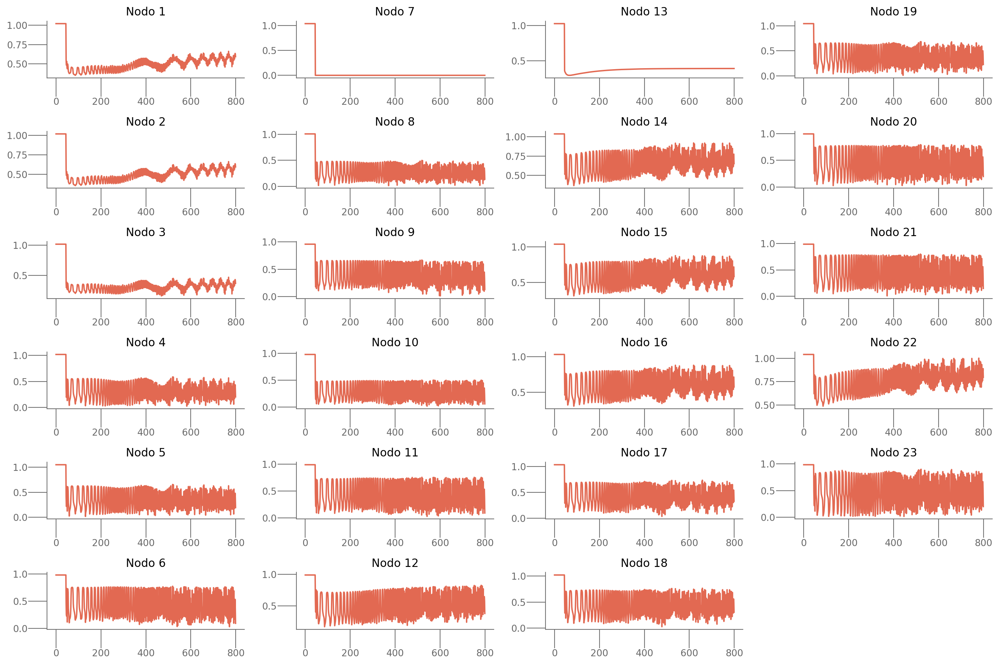

In [18]:
utils.utils_graph.plot_caso_concreto(3, loader)

In [9]:
utils.utils_graph.show_graph(dataset_full[0][3], loader, titulo="Grafo de la situación 0")

In [10]:
pd.DataFrame({'type':loader.types})['type'].value_counts()

gen_trip        184
branch_trip     101
branch_fault     92
bus_fault        86
bus_trip         86
Name: type, dtype: int64

In [12]:
problem = "gen_trip"
utils.utils_graph.plot_specific_problem(problem, loader)

NameError: name 'utils_graph' is not defined

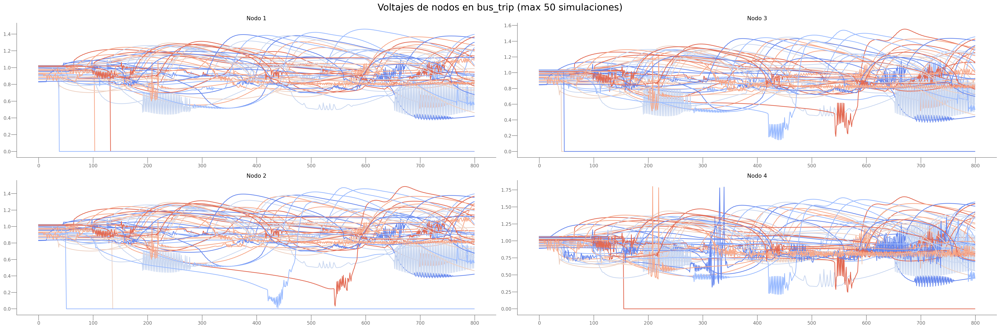

In [ ]:
problem = "bus_trip"
utils.utils_graph.plot_specific_problem(problem, loader)

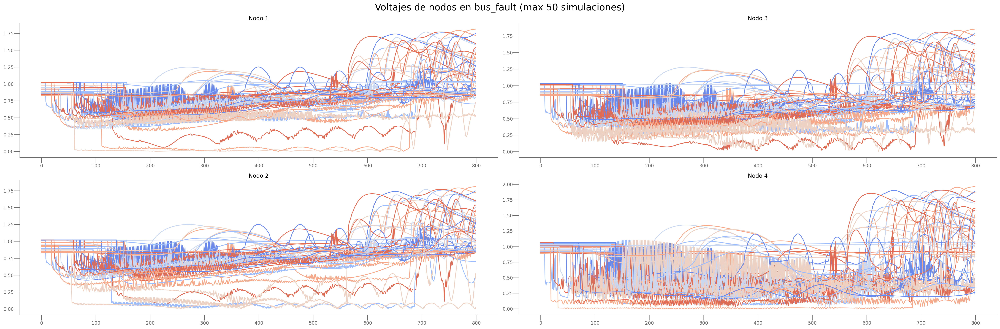

In [ ]:
problem = "bus_fault"
utils.utils_graph.plot_specific_problem(problem, loader)

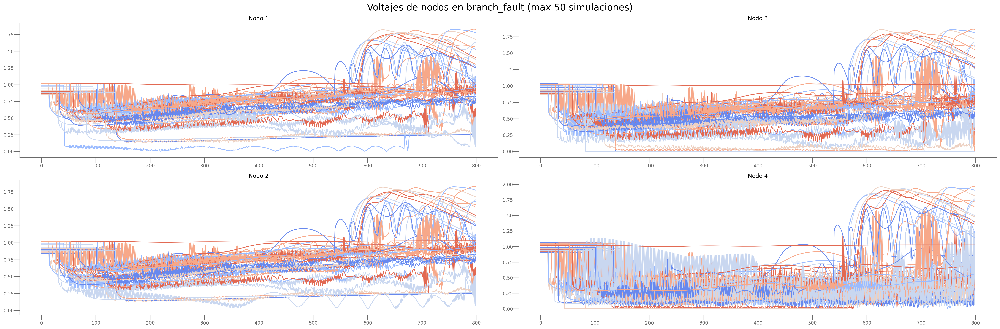

In [ ]:
problem ="branch_fault"
utils.utils_graph.plot_specific_problem(problem, loader)

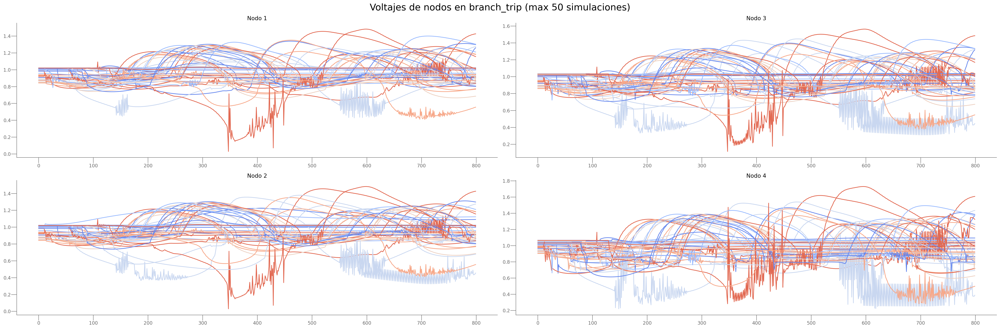

In [ ]:
problem ="branch_trip"
utils.utils_graph.plot_specific_problem(problem, loader)

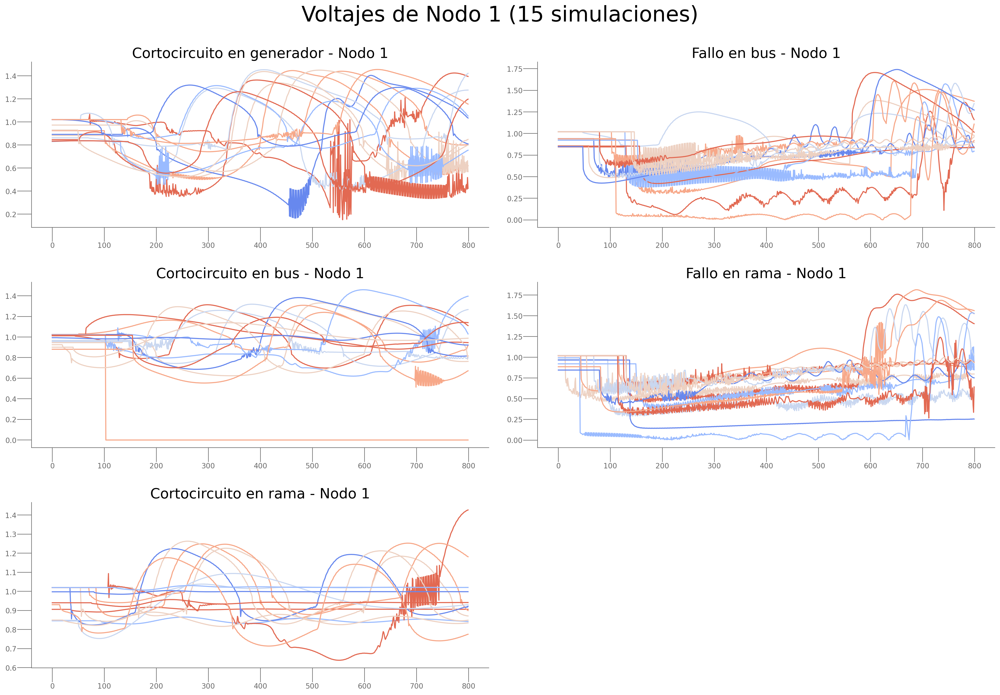

In [19]:
problems = ["gen_trip", "bus_trip", "branch_trip", "bus_fault", "branch_fault"]
problem_dict ={"gen_trip":"Cortocircuito en generador", "bus_trip":"Cortocircuito en bus", "branch_fault":"Fallo en rama", "branch_trip":"Cortocircuito en rama", "bus_fault":"Fallo en bus"}
    
    

n_plots = 5
n_cols = 2
n_rows = (n_plots + 1) // 2  # División redondeada hacia arriba
limite_situaciones = 15
fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, 14),dpi=200)

for i in range(len(problems)):
    problem = problems[i]
    indices = np.where(np.array(loader.types)==problem)[0][:limite_situaciones]
    info_nodos_full = [loader.reconstruir_voltages(m) for m in indices]
    
    
    row = i % n_rows  # Calculamos el índice de la fila
    col = i // n_rows  # Calculamos el índice de la columna
    ax = axs[row, col] if n_plots > 1 else axs
    
    ax = axs[row, col] if n_plots > 1 else axs
    
    for j in range(limite_situaciones):
        sns.lineplot(y=info_nodos_full[j][0],x=range(len(info_nodos_full[j][0])), ax=ax, label='Real', legend=False, linewidth=1.5)
     
    ax.set_title('{} - Nodo 1'.format(problem_dict[problem]), fontsize=20)
    format_plot(ax)
# Remove any unused subplots
if n_plots < (n_rows * n_cols):
    for i in range(n_plots, (n_rows * n_cols)):
        fig.delaxes(axs.flatten()[i])
# Ajustes finales
plt.suptitle('Voltajes de Nodo 1 ({} simulaciones)'.format(limite_situaciones), fontsize=30)
plt.tight_layout(pad=2.5)
plt.show()

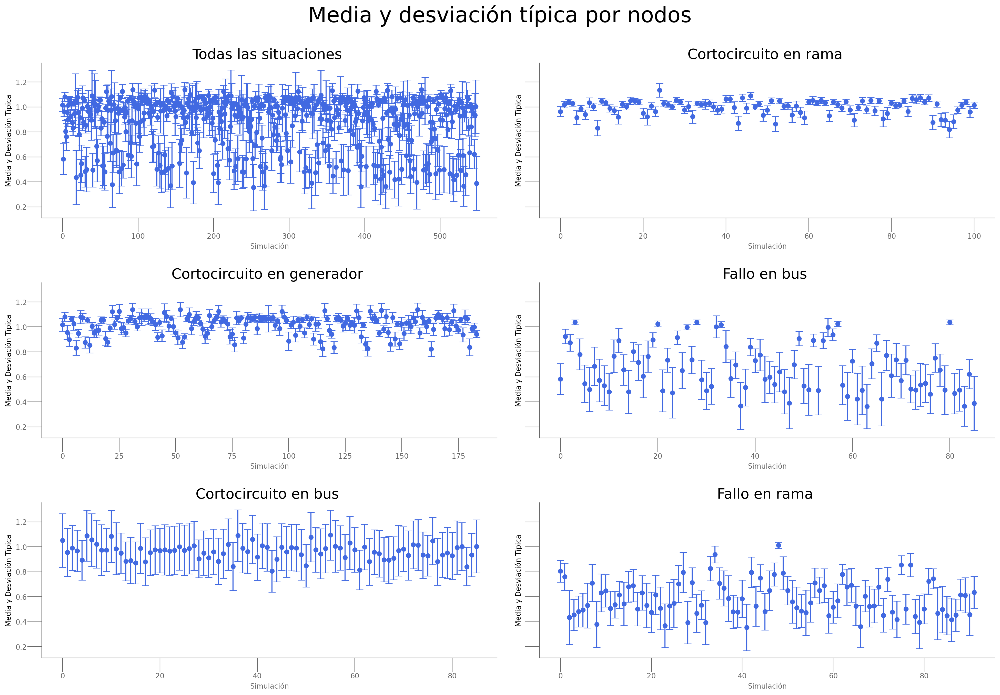

In [16]:


problems = ["gen_trip", "bus_trip", "branch_trip", "bus_fault", "branch_fault"]
problem_dict = {
    "completo": "Todas las situaciones",
    "gen_trip": "Cortocircuito en generador",
    "bus_trip": "Cortocircuito en bus",
    "branch_fault": "Fallo en rama",
    "branch_trip": "Cortocircuito en rama",
    "bus_fault": "Fallo en bus"
}

n_plots = 6
n_cols = 2
n_rows = (n_plots + 1) // 2  # División redondeada hacia arriba
limite_situaciones = 550
fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, 14), dpi=200, sharey=True)

# Iteración a través de los problemas
for i in range(len(problems) + 1):
    if i == 0:
        problem = "completo"
        indices = range(len(loader.types))[:limite_situaciones]
        info_nodos_full = [loader.reconstruir_voltages(m) for m in indices]
    else:
        problem = problems[i - 1]
        indices = np.where(np.array(loader.types) == problem)[0][:limite_situaciones]
        info_nodos_full = [loader.reconstruir_voltages(m) for m in indices]

    row = i % n_rows  # Calculamos el índice de la fila
    col = i // n_rows  # Calculamos el índice de la columna
    ax = axs[row, col] if n_plots > 1 else axs

    # Cálculo de la media y la desviación estándar entre nodos
    info_nodos_full_mean = np.mean(np.mean(info_nodos_full, axis=2), axis=1)
    info_nodos_full_std = np.std(np.mean(info_nodos_full, axis=2), axis=1)

    # Crear el gráfico de barras
    ax.errorbar(range(len(info_nodos_full_mean)), info_nodos_full_mean, yerr=info_nodos_full_std, fmt='o', capsize=5, color ="royalblue",label='Desviación Típica')

    ax.set_title('{} '.format(problem_dict[problem]), fontsize=20)
    ax.set_xlabel('Simulación')
    ax.set_ylabel('Media y Desviación Típica')
    format_plot(ax)

# Remove any unused subplots
if n_plots < (n_rows * n_cols):
    for i in range(n_plots, (n_rows * n_cols)):
        fig.delaxes(axs.flatten()[i])

# Ajustes finales
plt.suptitle('Media y desviación típica por nodos', fontsize=30)
plt.tight_layout(pad=2.5)
plt.show()


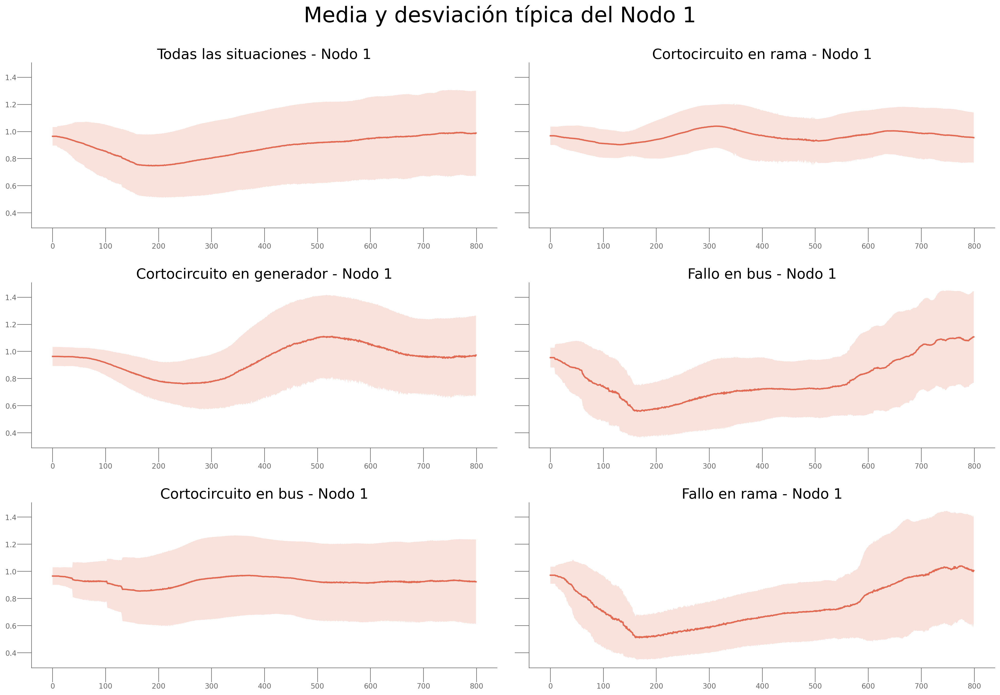

: 

In [20]:


problems = ["gen_trip", "bus_trip", "branch_trip", "bus_fault", "branch_fault"]
problem_dict = {
    "completo": "Todas las situaciones",
    "gen_trip": "Cortocircuito en generador",
    "bus_trip": "Cortocircuito en bus",
    "branch_fault": "Fallo en rama",
    "branch_trip": "Cortocircuito en rama",
    "bus_fault": "Fallo en bus"
}

n_plots = 6
n_cols = 2
n_rows = (n_plots + 1) // 2  # División redondeada hacia arriba
limite_situaciones = 550
fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, 14), dpi=200, sharey=True)

# Iteración a través de los problemas
for i in range(len(problems) + 1):
    if i == 0:
        problem = "completo"
        indices = range(len(loader.types))[:limite_situaciones]
        info_nodos_full = [loader.reconstruir_voltages(m) for m in indices]
    else:
        problem = problems[i - 1]
        indices = np.where(np.array(loader.types) == problem)[0][:limite_situaciones]
        info_nodos_full = [loader.reconstruir_voltages(m) for m in indices]

    row = i % n_rows  # Calculamos el índice de la fila
    col = i // n_rows  # Calculamos el índice de la columna
    ax = axs[row, col] if n_plots > 1 else axs

    # Cálculo de la media y la desviación estándar
    info_nodos_full_std = np.std(info_nodos_full, axis=0)
    info_nodos_full_mean = np.mean(info_nodos_full, axis=0)

    # Pintamos la línea de la media
    sns.lineplot(y=info_nodos_full_mean[0], x=range(len(info_nodos_full_mean[0])), ax=ax, linewidth=2)

    # Añadimos la banda de la desviación estándar
    ax.fill_between(range(len(info_nodos_full_mean[0])),
                    info_nodos_full_mean[0] - info_nodos_full_std[0],
                    info_nodos_full_mean[0] + info_nodos_full_std[0], alpha=0.2, label='Desviación Típica')

    ax.set_title('{} - Nodo 1'.format(problem_dict[problem]), fontsize=20)
    format_plot(ax)

# Remove any unused subplots
if n_plots < (n_rows * n_cols):
    for i in range(n_plots, (n_rows * n_cols)):
        fig.delaxes(axs.flatten()[i])

# Ajustes finales
plt.suptitle('Media y desviación típica del Nodo 1', fontsize=30)
plt.tight_layout(pad=2.5)
plt.show()